In [1]:
using Plots
using DifferentialEquations
#using LinearAlgebra
#using DiffEqOperators
using StatsBase
using NumericallyIntegrateArrays
using LaTeXStrings
using JLD2
using Distributions
push!(LOAD_PATH, "C:\\Users\\lucy_\\bats\\RoostFinder")
using RoostFinder

┌ Info: Recompiling stale cache file C:\Users\lucy_\.julia\compiled\v1.1\Plots\ld3vC.ji for Plots [91a5bcdd-55d7-5caf-9e0b-520d859cae80]
└ @ Base loading.jl:1184
┌ Info: Recompiling stale cache file C:\Users\lucy_\.julia\compiled\v1.1\RoostFinder\mNqOA.ji for RoostFinder [a11e2710-9687-11e9-2dd2-259d087faf94]
└ @ Base loading.jl:1184
┌ Warning: Package RoostFinder does not have Distances in its dependencies:
│ - If you have RoostFinder checked out for development and have
│   added Distances as a dependency but haven't updated your primary
│   environment's manifest file, try `Pkg.resolve()`.
│ - Otherwise you may need to report an issue with RoostFinder
└ Loading Distances into RoostFinder from project dependency, future warnings for RoostFinder are suppressed.


In [2]:
@load "radiotrack.jld2" t meansd semsd stdsd
t_rt = t 
msd_rt = meansd;
sem_rt = semsd;
std_rt = stdsd;

In [78]:
function r2_test(ydata,ymodel)
    """
    Calculate the r² value for ydata and ymodel
    Each point ydata and ymodel must be at the same x point
    """
    sstot = 0
    ssres = 0
    for (yd,ym) in zip(ydata,ymodel)
        sstot += (yd - mean(ydata))^2
        ssres += (yd - ym)^2
    end
    return 1- ssres/sstot
end

function diffusions!(du,u,p,t)
    d,n = p
    du[1] = d*(u[2]-u[1])
    for i = 2:n-1
       du[i] = d*(u[i-1]-2*u[i]+u[i+1])
    end
    du[n] = d*(u[n-1]-u[n])
end

function ABC(f::Function, d::Function, prior, N::Int, Y::Array)
    """
    f = a function to generate X values that takes as input a tuple of parameters θ.
    d = function giving a distance measure
    prior = a named tuple of parameter distributions
    N = number of samples
    Y = summary statistics of the data
    The function ABC generates N sets of parameters from priors, calculates
    summary statistics X from each set of parameters with f and calculates
    distance measure from the function given by d.
    Then, sorts parameters θ by distance and returns θ and distance
    """
    distance=[]
    θ = []
    for p in prior
        append!(θ, [rand(p, N)])
    end
    for i in 1:N
        θs = [θ[v][i] for v in 1:length(θ)]
        X = f(θs)
        append!(distance, d(X,Y))
    end
    for (i,p) in enumerate(θ)
        θ[i] = p[sortperm(distance)]
    end
    sort!(distance)
    return θ, distance
end

function shrink_rate(ts,θ)
    a = (θ[1]-1)./ts[end]^2
    return sqrt.(θ[1] .- a.*ts.^2)#(abs.(θ[1] .- θ[2]*ts)).^(1/4)
end

function domain_shrink(θ, d, dt,u0, t, tD)
    boxsize = Int.(ceil.(shrink_rate(t,θ)./dx))
    tspan = (0.0, dt)
    msd = [trapz(u0.*x[1:size(u0)[1]].^2,dx)]
    for (i,ts) in enumerate(t[1:end-1])
        if ts > tD
            ns = length(u0)
            prob = ODEProblem(diffusions!,u0,tspan,(d,ns))
            u0 = solve(prob).u[end]
            if boxsize[i+1] < length(u0) && boxsize[i+1] < boxsize[i]
                u0[boxsize[i+1]] += sum(u0[boxsize[i+1]+1:end])
                u0 = u0[1:boxsize[i+1]]
            end
        end            
        append!(msd,trapz(u0.*x[1:size(u0)[1]].^2,dx))
    end
    return msd
end

function fs(θ, dt, u0, t, msd_rt)
    """
    This is the function to be minimised.
    """
    X = domain_shrink(θ, dt,u0, t)
    a = (X.-msd_rt)^2
    return a[1]
end

function GMM(prior, dt, u0, t, msd_rt)
    result = bboptimize(θ->fs(θ, dt, u0, t, msd_rt);
    SearchRange = prior,
    TraceMode=:silent
    )
return best_candidate(result)
end

GMM (generic function with 1 method)

In [76]:
L = 4000
N = 1000
dx = div(L,N)
D = 62.87
d = 2D/dx^2
u = zeros(N)
T = 3600
dt = 200.0
tD = 0.0#600.0

#IC is solution to diffusion equation at time T

x = dx:dx:L
u0 = zeros(size(x))
u0[1] = 1/dx

n = 500

prior = [Uniform(2e6,5e6)]
θ = 3e6
@time msds = domain_shrink(θ,d,dt,u0,t_rt, tD);
    
    

3.0e6 12.040800 seconds (3.82 M allocations: 562.271 MiB, 1.12% gc time)


0.848032444191146

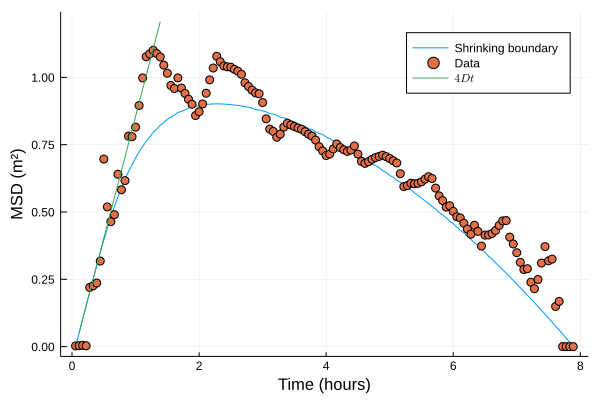

In [69]:
print(r2_test(msds,msd_rt))
plot(t_rt./3600, msds./1e6, label="Shrinking boundary")
scatter!(t_rt./3600,msd_rt./1e6,label="Data")
plot!(t_rt[2:25]./3600,4*D*(t_rt[1:24])./1e6, label=L"4Dt")
plot!(xlabel="Time (hours)",ylabel="MSD (m²)")
#savefig("shrinking_bound.png")

In [ ]:
@time θ, distance = ABC(θ -> domain_shrink(θ,d,dt,u0,t_rt,tD), r2_test, prior, N, msd_rt)

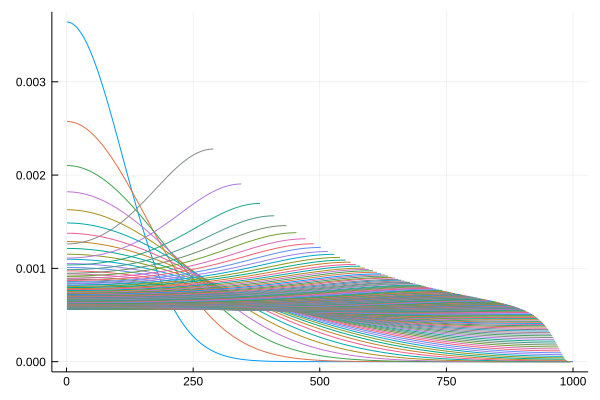

In [39]:
dt = 200.0
tspan = (0.0, dt)
u0 = zeros(size(x))
u0[1] = 1/dx
phiint = []
msd = [trapz(u0.*x[1:size(u0)[1]].^2,dx)]
tsteps = 10

boxsize = Int.(ceil.(shrink_rate(t_rt, θ)./dx))
plot(legend=false)
for (i,ts) in enumerate(t_rt[1:end-1])
    ns = length(u0)
    prob = ODEProblem(diffusions!,u0,tspan,(d,ns))
    u0 = solve(prob).u[end]
    plot!(u0)
    u0[boxsize[i+1]] += sum(u0[boxsize[i+1]+1:end])
    u0 = u0[1:boxsize[i+1]]
    #end
    append!(phiint,trapz(u0,dx))
    append!(msd,trapz(u0.*x[1:size(u0)[1]].^2,dx))
end
plot!()

In [30]:
dt = 200.0
tspan = (0.0, dt)
u0 = zeros(size(x))
u0[1] = 1/dx
phiint = []
msd = [trapz(u0.*x[1:size(u0)[1]].^2,dx)]
tsteps = 10

boxsize = Int.(ceil.(shrink_rate(t_rt, θ)))
plot(legend=false)
for (i,ts) in enumerate(t_rt)
    ns = length(u0)
    prob = ODEProblem(diffusions!,u0,tspan,(d,ns))
    u0 = solve(prob).u[end]
    #print("size(u0) = ", size(u0), ",  ns = ", ns, ", ", boxsize[i]-boxsize[i+1], "boxes dropped \n")
    plot!(u0)
    if boxsize[i+1] != boxsize[i]
        u0[ns-(boxsize[i]-boxsize[i+1])] += sum(u0[ns-(boxsize[i]-boxsize[i+1])+1:ns])
        u0 = u0[1:ns-(boxsize[i]-boxsize[i+1])]
    end
    append!(phiint,trapz(u0,dx))
    append!(msd,trapz(u0.*x[1:size(u0)[1]].^2,dx))
end
plot!()

BoundsError: BoundsError: attempt to access 7-element Array{Float64,1} at index [-22]

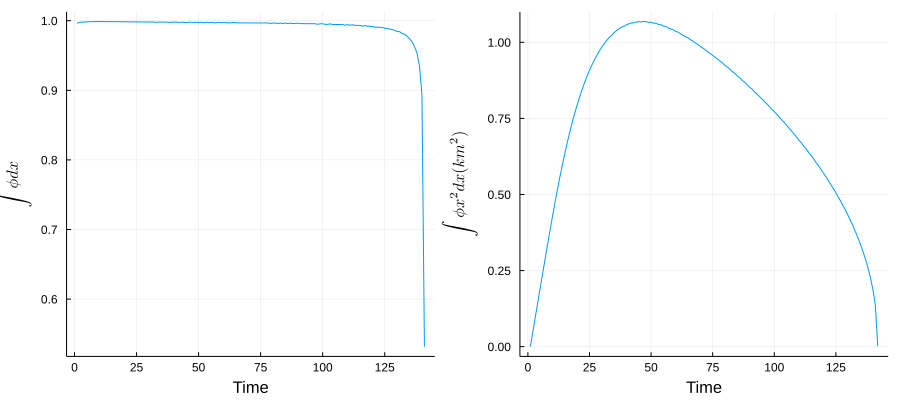

In [40]:
p1 = plot(phiint, legend=false,xlabel="Time",ylabel=L"\int \phi dx")
p2 = plot(msd./1e6, legend=false,xlabel="Time",ylabel=string(L"\int \phi x^2 dx (km^2)"))
plot(p1,p2,size=(900,400))

In [41]:
r2_test(msd_rt, msd)

0.673408608608256

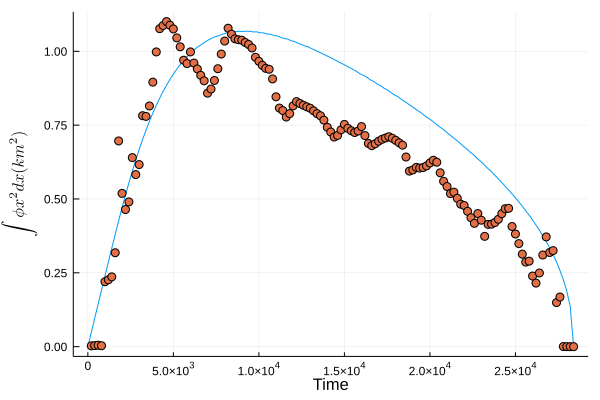

In [43]:
plot(range(0,t_rt[end],length=length(msd_rt)),msd./1e6, legend=false,xlabel="Time",ylabel=string(L"\int \phi x^2 dx (km^2)"))
scatter!(t_rt,msd_rt./1e6)

In [25]:
dt = 200.0
tspan = (0.0, dt)
u0 = zeros(size(x))
phiint = []
msd = []
tsteps = 500

D = 500
d = D/dx

u0 .= 1/L
#for (i,xs) in enumerate(x)
#    u0[i] = 2/sqrt(2*pi*D*T)*exp(-xs^2/(2*D*T))
#end


plot(legend=false)
for i = 1:tsteps
    ns = length(u0)
    prob = ODEProblem(diffusions!,u0,tspan,(d,ns))
    u0 = solve(prob).u[end]
    plot!(u0)
    #if i%10 == 0
        u0[ns-1] += u0[ns]           
        u0[ns] = 0
        u0 = u0[1:ns-1]
    #end
    append!(phiint,trapz(u0,dx))
    append!(msd,trapz(u0.*x[1:size(u0)[1]].^2,dx))
end
plot!()

In [104]:
p1 = plot(dt:dt:dt*tsteps-1, phiint, legend=false,xlabel="Time",ylabel=L"\int \phi dx")
p2 = plot(dt:dt:dt*tsteps-1, msd, legend=false,xlabel="Time",ylabel=L"\int \phi x^2 dx")
plot(p1,p2,size=(900,400))

BoundsError: BoundsError: attempt to access 998-element Array{Float64,1} at index [1:999]

In [66]:
u0

plot(legend=false)
for i = tsteps+1:2tsteps
    ns = length(u0)
    prob = ODEProblem(diffusions!,u0,tspan,(d,ns))
    u0 = solve(prob).u[end]
    plot!(u0)
    if i%10 == 0
        u0[ns-1] += u0[ns]           
        u0[ns] = 0
        u0 = u0[1:ns-1]
    end
    append!(phiint,trapz(u0,dx))
    append!(msd,trapz(u0.*x[1:size(u0)[1]].^2,dx))
end
plot!()

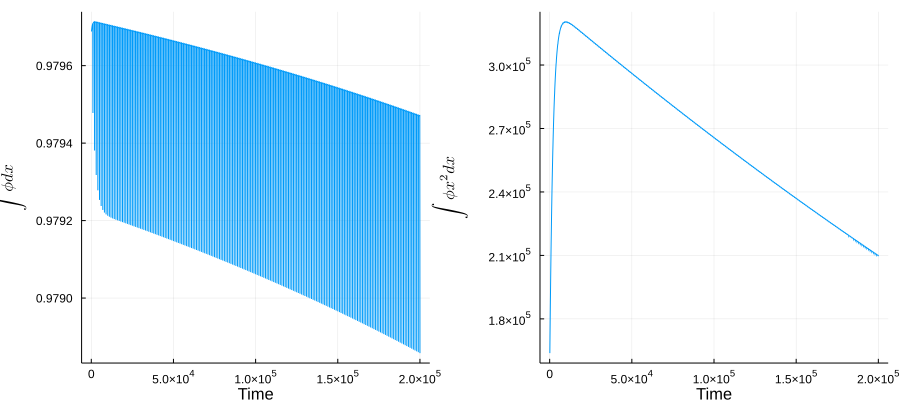

In [68]:
using LaTeXStrings
p1 = plot(dt:dt:dt*tsteps*2, phiint, legend=false,xlabel="Time",ylabel=L"\int \phi dx")
p2 = plot(dt:dt:dt*tsteps*2, msd, legend=false,xlabel="Time",ylabel=L"\int \phi x^2 dx")
plot(p1,p2,size=(900,400))

In [60]:
dt = 100.0
tspan = (0.0, dt)
u0 = zeros(size(x))
phiint = []
msd = []
uvals = []
tsteps = 500#5000
for (i,xs) in enumerate(x)
    u0[i] = 2/sqrt(2*pi*D*T)*exp(-xs^2/(2*D*T))
end


plot(legend=false)
for i = 1:tsteps
    ns = length(u0)
    prob = ODEProblem(diffusions!,u0,tspan,(d,ns))
    u0 = solve(prob).u[end]
    plot!(u0)
    #if i%10 == 0
        u0[ns-1] += u0[ns]           
        u0[ns] = 0
        u0 = u0[1:ns-1]
    #end
    push!(uvals,u0)
    append!(phiint,trapz(u0,dx))
    append!(msd,trapz(u0.*x[1:size(u0)[1]].^2,dx))
end
plot!()

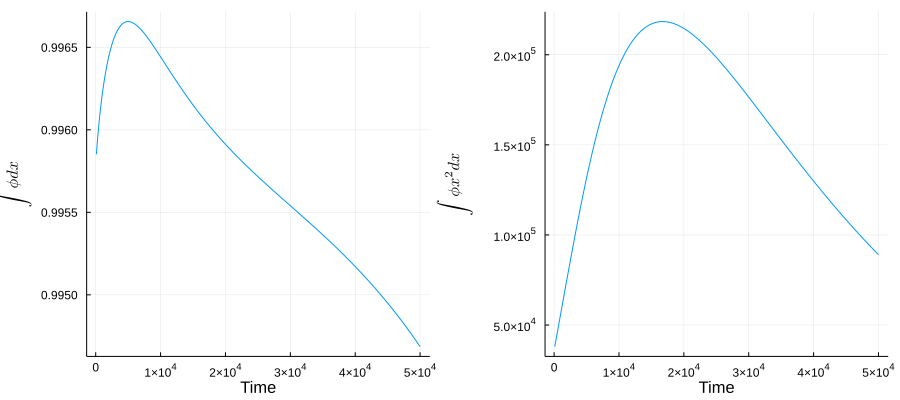

In [61]:
using LaTeXStrings
p1 = plot(dt:dt:dt*tsteps, phiint, legend=false,xlabel="Time",ylabel=L"\int \phi dx")
p2 = plot(dt:dt:dt*tsteps, msd, legend=false,xlabel="Time",ylabel=L"\int \phi x^2 dx")
plot(p1,p2,size=(900,400))

Finide difference approximations to derivatives using DiffEqOperators.jl

In [35]:
N = 1000
D = 75

#const M = Tridiagonal([1.0 for i in 1:N-1],[-2.0 for i in 1:N],[1.0 for i in 1:N-1])
# Do the reflections, different for x and y operators
#M[2,1] = 2.0
#M[end-1,end] = 2.0

order = 2
deriv = 2
const dx = 0.1
D = CenteredDifference{1}(deriv,order,dx,N)
Q = Dirichlet0BC()


MethodError: MethodError: no method matching Dirichlet0BC()
Closest candidates are:
  Dirichlet0BC(!Matched::Type) at C:\Users\lucy_\.julia\packages\DiffEqOperators\u3MdC\src\derivative_operators\BC_operators.jl:142
  Dirichlet0BC(!Matched::Type, !Matched::Any) at C:\Users\lucy_\.julia\packages\DiffEqOperators\u3MdC\src\derivative_operators\multi_dim_bc_operators.jl:108

In [36]:
Q = Neumann0BC(dx, 1)

RobinBC{Float64,Array{Float64,1}}([1.0], -0.0, [1.0], 0.0)

In [37]:

tspan = (0.0,100.0)
u0 = zeros(N);
u0[1] = 1;

function f(du,u,p,t)
  Du = D*(M*u)
  @. du = Du 
end

prob = ODEProblem(f,u0,tspan)
sol = solve(prob,BS3());

ErrorException: cannot define function f; it already has a value

@. is inplace updates to du, updating the full ArrayPartition

In [38]:
plot(1:N,sol.u[900])

UndefVarError: UndefVarError: sol not defined

In [20]:
grid

Grid{2,4,Float64,4} with 400 Quadrilateral cells and 441 nodes

In [2]:
using ApproxFun
using Plots
using LinearAlgebra

We can solve PDEs, the following solves Helmholtz Δu + 100u=0 with u(±1,y)=u(x,±1)=1 on a square. This function has weak singularities at the corner, so we specify a lower tolerance to avoid resolving these singularities completely.

ApproxFunBase.Neumann — Function.
Neumann(sp) is the operator associated with restricting the normal derivative on the boundary for the space sp. At the moment it is implemented as Dirichlet(sp,1).

In [27]:
d = ChebyshevInterval()^2                        # Defines a rectangle
Δ = Laplacian(d)                            # Represent the Laplacian
#D = Derivative(d)
f = ones(∂(d))                              # one at the boundary
u = \([Dirichlet(d); Δ+100I], [f;0.];       # Solve the PDE
                tolerance=1E-5)             
contour(u,fill=true)                                  # Surface plot

In [ ]:
d = Domain(-1..1)^2
x,y = Fun(d)
Δ = Laplacian(d)
f = -10(x+0.3)^2-20(y-0.2)^2 #exp.(-10(x+0.3)^2-20(y-0.2)^2)  # use broadcasting as exp(f) not implemented in 2D
A = [Dirichlet(d);Δ]              # Δ is an alias for Laplacian()
@time u = A \ [zeros(∂(d));f]     #4s for ~3k coefficients

contour(u,fill=true)

In [ ]:
contour(u,fill=true)

In [31]:
d = Circle(1,0.5) #Circle(c,r)
D = Derivative(d)

f = ones(∂(d))                              # one at the boundary
#u = \([Dirichlet(d); Δ+100I], [f;0.];       # Solve the PDE
                tolerance=1E-5)             
#contour(u,fill=true) 

UndefVarError: UndefVarError: EmptyDomain not defined

In [16]:
d = Circle(1,0.5)^2                           # Defines a rectangle
Δ = Laplacian(d)                            # Represent the Laplacian
f = ones(∂(d))                              # one at the boundary
u = \([Dirichlet(d); Δ+ 100I], [f;0.];       # Solve the PDE
                tolerance=1E-5)             
contour(u)                                  # Surface plot

MethodError: MethodError: no method matching boundary(::DomainSets.ProductDomain{Tuple{Circle{Int64,Float64,Complex{Float64}},Circle{Int64,Float64,Complex{Float64}}},Tuple{Complex{Float64},Complex{Float64}},StaticArrays.SArray{Tuple{2},Complex{Float64},1,2}})
Closest candidates are:
  boundary(!Matched::IntervalSets.TypedEndpointsInterval{:closed,:closed,T} where T) at C:\Users\lucy_\.julia\packages\DomainSets\D8lcW\src\domains\interval.jl:26
  boundary(!Matched::IntervalSets.TypedEndpointsInterval{:closed,:open,T} where T) at C:\Users\lucy_\.julia\packages\DomainSets\D8lcW\src\domains\interval.jl:27
  boundary(!Matched::IntervalSets.TypedEndpointsInterval{:open,:closed,T} where T) at C:\Users\lucy_\.julia\packages\DomainSets\D8lcW\src\domains\interval.jl:28
  ...

In [17]:
d = Domain(-1..1)^2
x,y = Fun(d)
f = exp.(-10(x+0.3)^2-20(y-0.2)^2)  # use broadcasting as exp(f) not implemented in 2D
A = [Dirichlet(d);Δ]              # Δ is an alias for Laplacian()
@time u = A \ [zeros(∂(d));f]     #4s for ~3k coefficients

MethodError: MethodError: no method matching (::ProductFun{Chebyshev{Interval{:closed,:closed,Int64},Float64},Chebyshev{Interval{:closed,:closed,Int64},Float64},TensorSpace{Tuple{Chebyshev{Interval{:closed,:closed,Int64},Float64},Chebyshev{Interval{:closed,:closed,Int64},Float64}},DomainSets.ProductDomain{Tuple{Interval{:closed,:closed,Int64},Interval{:closed,:closed,Int64}},Tuple{Int64,Int64},StaticArrays.SArray{Tuple{2},Int64,1,2}},Float64},Float64})(::Float64)
Closest candidates are:
  ProductFun(::Any, !Matched::Any) at C:\Users\lucy_\.julia\packages\ApproxFunBase\Ak6LI\src\Multivariate\ProductFun.jl:176
  ProductFun(::Any, !Matched::Any, !Matched::Any) at C:\Users\lucy_\.julia\packages\ApproxFunBase\Ak6LI\src\Multivariate\ProductFun.jl:177